# Testing model

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import glob
from load_data import df2data
from src.data import get_image_dataset
import tensorflow as tf
import numpy as np
from metrices import conf_matrix, roc
from sklearn.preprocessing import label_binarize
import json
from load_data import load_data_fn
import os
from keras.utils import plot_model
from tensorflow.keras.utils import to_categorical

pd.set_option('display.max_columns', 60)
pd.set_option('display.width', 50000)

Using TensorFlow backend.


In [2]:
config_file = 'configs/config_cat_model.json'
fig_save_path = r'C:\Users\yga\PycharmProjects\categorizer_tool\models\2019_9_3'
csv_path = r"C:\Users\yga\PycharmProjects\categorizer_tool\models\2019_9_3\TrainLog_categorizor_tool_densenet201_0.0001_2019-09-03--02-10.csv"
model_name = r"C:\Users\yga\PycharmProjects\categorizer_tool\models\2019_9_3\categorizor_tool_densenet201_1e-05_2019-09-03--06-28.hdf5"

In [3]:
df_csv = pd.read_csv(csv_path)
df_csv

,epoch,acc,loss,val_acc,val_loss
0,0,0.922356,0.253853,0.952902,0.145222
1,1,0.945325,0.171283,0.952173,0.152547
2,2,0.956815,0.135065,0.961576,0.121227
3,3,0.965450,0.106015,0.962305,0.130445


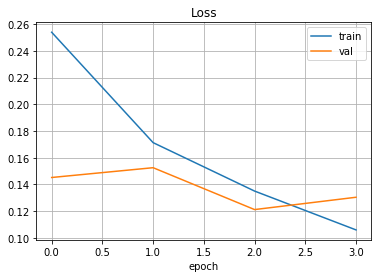

In [4]:
plt.plot(df_csv['loss'])
plt.plot(df_csv['val_loss'])
plt.title('Loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper right')
plt.grid()
plt.show()

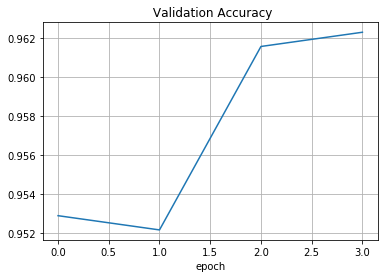

In [5]:
plt.plot(df_csv['val_acc'])
plt.title(' Validation Accuracy')
plt.xlabel('epoch')
plt.grid()
plt.show()

In [ ]:
# with open(config_file) as json_file:
#     params = json.load(json_file)

# image_size = (params['height'],['params.width'])

# _, _, _, _, test_img, test_labels = load_data_fn(params)

In [ ]:
# Load testset from csv

csv_path = r"C:\Users\yga\PycharmProjects\categorizer_tool\csv_files\ver3_3_9_2019\test_set_3_9_2019.csv"
img_dir = "D:\BOCI_categorized\data_set"

test_set_df = pd.read_csv(csv_path)
test_set_df.drop(['Unnamed: 0'], inplace=True, axis=1)
test_set_df['filename']= test_set_df.filename.apply(lambda x:os.path.join(img_dir, x.split("/")[-2], x.split("/")[-1]))
test_set_df['prediction'] = 0
test_set_df.head()

In [ ]:
test_img, test_labels = df2data(test_set_df)

In [6]:
# Load testing images from folder
classe_labels = {'Car_components': 0, 'Documents': 1, 'Car_human': 2, 'Car_interior': 3, 'Car_perspective': 4,
                 'Car_zoom': 5, 'Others': 6, 'Trucks': 7, 'Vin': 8, 'Wheels': 9}

dir_path = r"D:\BOCI_categorized\test_data_Wu\Wu_Data_23_8_2019"
all_files = glob.glob(dir_path + "\\*\\*")
imagefiles = [file for file in all_files if file.split('\\')[-1].split('.')[-1].lower() in ['jpg', 'jpeg', 'png']]

test_set_df = pd.DataFrame(columns=['filename', 'category'])
test_set_df['filename'] = imagefiles
test_set_df['category'] = 0
test_set_df['prediction'] = 0

for idx, i in enumerate(test_set_df['filename']):
    cat_name = i.split("\\")[-2]
    test_set_df.loc[idx, 'category'] = classe_labels[cat_name]

test_set_df.head()

test_img, test_labels = df2data(test_set_df)

In [ ]:
# test_img = test_set_df.filename.tolist()
# test_labels = dict()
# test_labels['category'] = to_categorical(test_set_df.loc[:, ['category']].values, 10)

In [9]:
test_generator = get_image_dataset(test_img, test_labels, size=(224, 224),
                                   batch_size=1, epochs=1, train=False,
                                   num_parallel_calls=1, buffersize=8,
                                   keep_aspect_ratio=False)

In [10]:
model = tf.keras.models.load_model(model_name)
optimizer = tf.train.AdamOptimizer(0.00001)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
plot_model(model, to_file="model.png")
model.summary()

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
densenet201 (Model)          (None, 1920)              18321984  
_________________________________________________________________
dense (Dense)                (None, 128)               245888    
_________________________________________________________________
dropout (Dropout)            (None, 128)               0         
_________________________________________________________________
category (Dense)             (None, 10)                1290      
Total params: 18,569,162
Trainable params: 18,340,106
Non-trainable params: 229,056
___

In [11]:
y_preds = model.predict(test_generator, steps=len(test_img)//1)

In [12]:
for idx, j in enumerate(y_preds):
    test_set_df.loc[idx, 'prediction'] = np.argmax(j)

# Classes
classes = {0: 'Car_components',1: 'Documents', 2: 'Car_human', 3: 'Car_interior', 4: 'Car_perspective', 5: 'Car_zoom', 6: 'Others', 7: 'Trucks', 8: 'Vin', 9: 'Wheels'}

In [13]:
test_set_df.head()

,filename,category,prediction
0,D:\BOCI_categorized\test_data_Wu\Wu_Data_23_8_...,0,0
1,D:\BOCI_categorized\test_data_Wu\Wu_Data_23_8_...,0,3
2,D:\BOCI_categorized\test_data_Wu\Wu_Data_23_8_...,0,0
3,D:\BOCI_categorized\test_data_Wu\Wu_Data_23_8_...,0,0
4,D:\BOCI_categorized\test_data_Wu\Wu_Data_23_8_...,0,0


In [ ]:
for idx, j in enumerate(test_set_df['filename']):
    file_name = j.split("\\")[-1]
    print(idx+1, ':', file_name)    
    for c in np.argsort(-y_preds[idx])[:3]:
        print(classes[c],':', np.round(y_preds[idx][c], decimals=6))
    img_array = plt.imread(j)
    plt.imshow(img_array)  
    plt.show()
    print('\t')

In [16]:
# Wrongly categorized images
wrg_index = test_set_df[test_set_df['category']!=test_set_df['prediction']].index

1 : 00849B0C028341FC9E74C655F6D133DA.jpg
Car_interior : 0.529343
Car_components : 0.309028
Wheels : 0.127755
True Label : Car_components


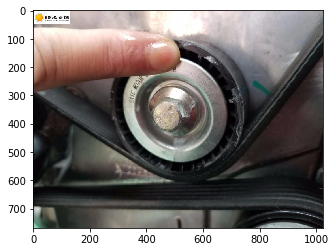

	
2 : 0E0D7D5D45E2471E8D36FCCCD846F811.jpg
Trucks : 0.533428
Car_components : 0.336987
Others : 0.070835
True Label : Car_components


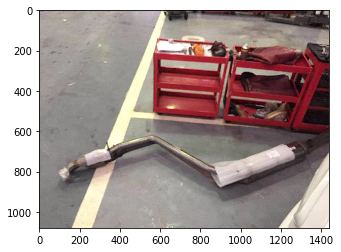

	
3 : 0EB084AAD9DC45589FD05F9C04A36225.jpg
Car_interior : 0.997787
Trucks : 0.001335
Car_zoom : 0.000636
True Label : Car_components


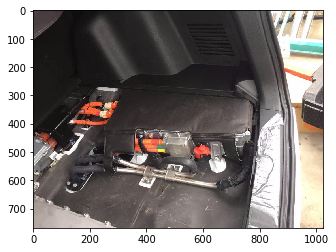

	
4 : 199EEBEFBB434202891FF41A4459E63B.jpg
Others : 0.495114
Car_perspective : 0.253422
Car_human : 0.081701
True Label : Car_components


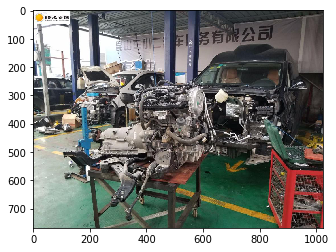

	
5 : 1CA5F749140140DE9EE1DE0D7F05B409.jpg
Trucks : 0.8044
Car_zoom : 0.155039
Car_components : 0.018069
True Label : Car_components


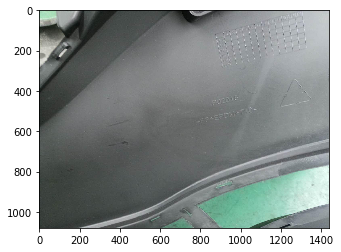

	
6 : 1DB7FFDF7E764E4F8E753A2C113530A6.jpg
Car_interior : 0.999971
Car_components : 2.6e-05
Trucks : 1e-06
True Label : Car_components


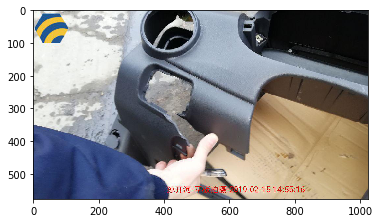

	
7 : 2437141A346344EBAC65AF85B7C50D54.jpg
Car_interior : 0.999657
Car_components : 0.000238
Trucks : 9.3e-05
True Label : Car_components


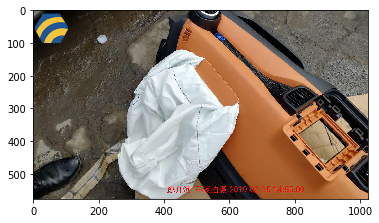

	
8 : 25A32367EAA94047AEC3AF85DD4D03C3.jpg
Car_interior : 0.950938
Car_zoom : 0.03784
Car_components : 0.00606
True Label : Car_components


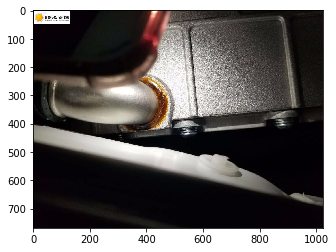

	
9 : 303734FA6C0348488D8758410A514E0F.jpg
Car_zoom : 0.891383
Car_components : 0.094893
Trucks : 0.010569
True Label : Car_components


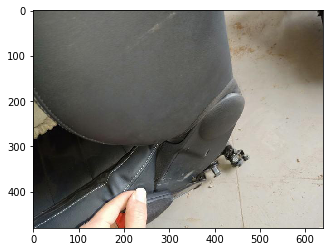

	
10 : 3125B42804A5474EB7CD5F532850E3C2.jpg
Vin : 0.436126
Car_interior : 0.287208
Wheels : 0.126919
True Label : Car_components


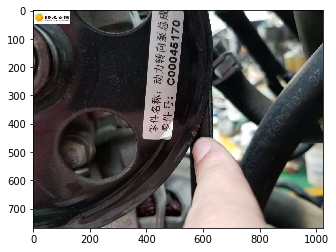

	
11 : 36EE6D3C189B479CB815BB379D1D7EDB.jpg
Trucks : 0.247444
Others : 0.245556
Car_zoom : 0.238349
True Label : Car_components


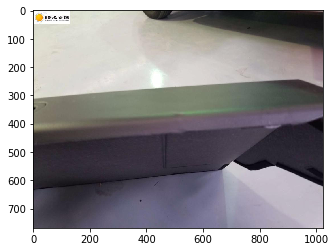

	
12 : 37E41B64E08C461FBD94888D8A9B1471.jpg
Trucks : 0.920234
Others : 0.048901
Car_components : 0.01758
True Label : Car_components


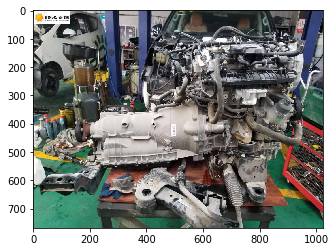

	
13 : 38E1E37CF36A4F37968B099BD6D6C794.jpg
Car_zoom : 0.715026
Car_components : 0.172527
Trucks : 0.048718
True Label : Car_components


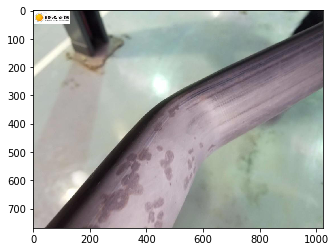

	
14 : 3967FD3F946849669D28ECC72F95DBF0.jpg
Vin : 0.346787
Car_components : 0.262333
Car_zoom : 0.147968
True Label : Car_components


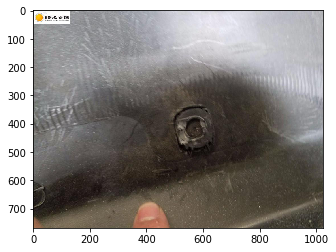

	
15 : 434E01FAA58745E4BD1FE303AEB38A17.jpg
Car_interior : 0.749981
Car_zoom : 0.133921
Trucks : 0.049056
True Label : Car_components


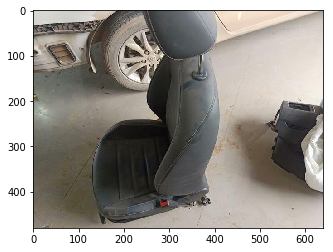

	
16 : 4748DEED9F2C44D6984CB70C67822E44.jpg
Car_zoom : 0.301166
Others : 0.292124
Car_interior : 0.122933
True Label : Car_components


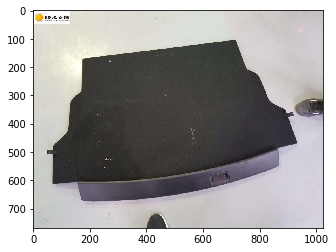

	
17 : 4BF9A21084A24EB3B0FEEBEA3E6839E4.jpg
Car_interior : 0.999991
Car_components : 6e-06
Others : 1e-06
True Label : Car_components


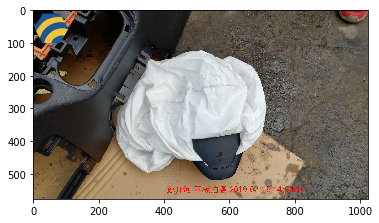

	
18 : 5186646A66C6445388F0D91ACF6FC47C.jpg
Car_zoom : 0.428352
Car_components : 0.390994
Trucks : 0.122248
True Label : Car_components


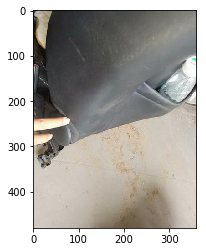

	
19 : 537D21A3FC8745B1AA80180C03F23A5E.jpg
Vin : 0.655359
Car_components : 0.205402
Car_zoom : 0.08609
True Label : Car_components


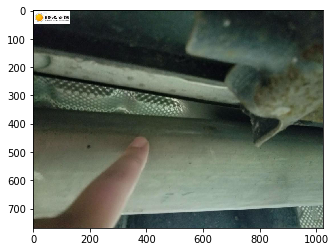

	
20 : 6331FC30FCC34FF2985E78F8EBB555D6.jpg
Car_interior : 0.668248
Car_components : 0.32293
Car_zoom : 0.003224
True Label : Car_components


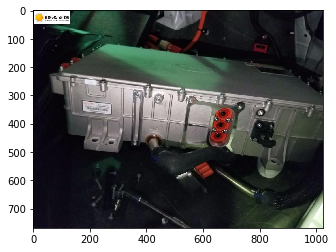

	
21 : 64B8D6BF491E448399E7176DDC3C5C5C.jpg
Documents : 0.699371
Others : 0.202535
Car_components : 0.064563
True Label : Car_components


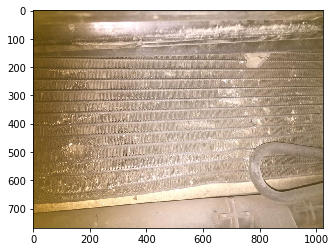

	
22 : 684BC20D906849DA83FF3213559D51A7.jpg
Car_perspective : 0.94097
Car_zoom : 0.045729
Car_components : 0.005533
True Label : Car_components


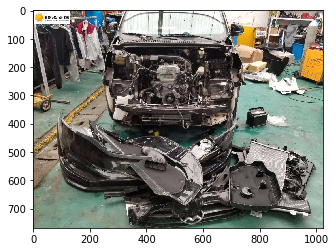

	
23 : 6C8BBE7D7B3048C09A35463C4F5EA6CD.jpg
Trucks : 0.304612
Car_components : 0.274264
Others : 0.243216
True Label : Car_components


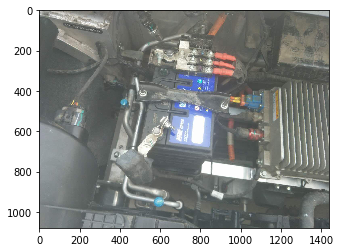

	
24 : 75EE9D828F6D4248BA6248861C0F3BBE.jpg
Car_interior : 0.839805
Car_components : 0.153301
Car_zoom : 0.00339
True Label : Car_components


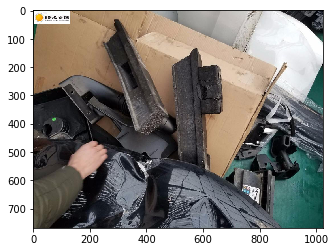

	
25 : 787EB3769A234129B0C7A655412AE5B6.jpg
Car_interior : 0.743314
Car_zoom : 0.129596
Car_components : 0.094534
True Label : Car_components


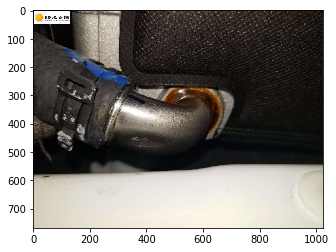

	
26 : 83BB2A21254244F88071C5DEA2A17FE3.jpg
Car_interior : 0.498781
Car_components : 0.353929
Trucks : 0.056496
True Label : Car_components


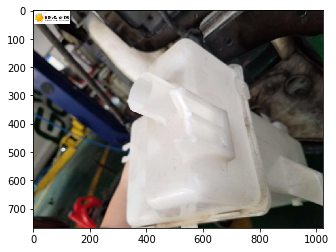

	
27 : 989C9D0117BF4D6795DCB495985B27D1.jpg
Car_zoom : 0.444053
Car_components : 0.383709
Trucks : 0.099505
True Label : Car_components


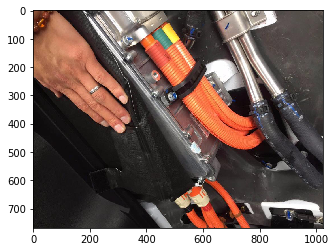

	
28 : 99BAB472B301419FA0FB656C2AB3114B.jpg
Wheels : 0.987224
Car_zoom : 0.00904
Car_components : 0.002507
True Label : Car_components


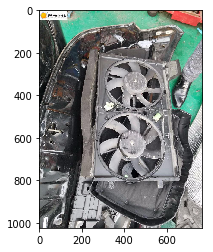

	
29 : A82BED5FDDF6476FA864761687F2E465.jpg
Car_interior : 0.649033
Car_components : 0.335786
Others : 0.00683
True Label : Car_components


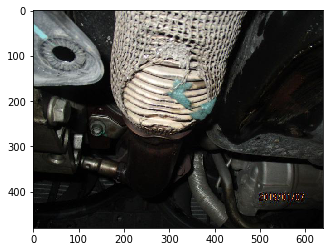

	
30 : D537116D61E24978BCBB10E83BDA97A4.jpg
Car_interior : 0.997164
Car_components : 0.002349
Trucks : 0.000462
True Label : Car_components


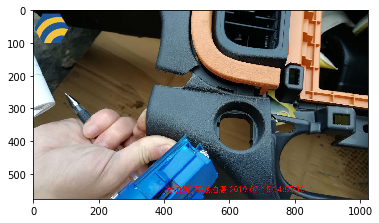

	
31 : EB8ED8965ECF4A9D8F0964C2983E0C50.jpg
Trucks : 0.777569
Car_components : 0.124834
Car_interior : 0.036341
True Label : Car_components


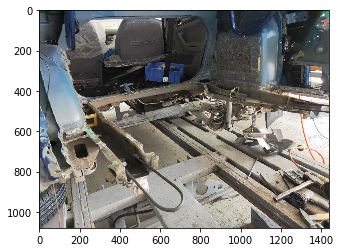

	
32 : F83D9C01B07A4B86B3875D3FF76483DB.jpg
Others : 0.85167
Car_components : 0.106919
Documents : 0.019785
True Label : Car_components


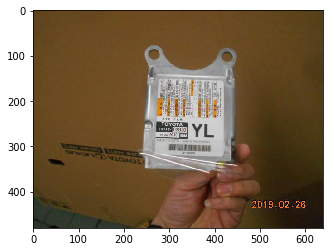

	
33 : FB1054A3884D4E0DA35E20AF5D5A70F7.jpg
Car_interior : 0.999616
Car_zoom : 0.000148
Trucks : 9.5e-05
True Label : Car_components


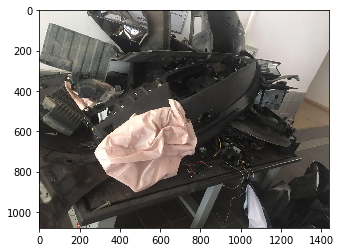

	
34 : FDE80BD0B2354267985B9B7FB64BE326.jpg
Car_interior : 0.929788
Car_components : 0.066845
Wheels : 0.00146
True Label : Car_components


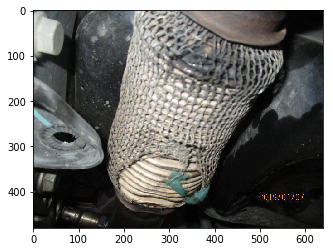

	
35 : FEBD9E0C623E47F0B86F9F0C2A753F39.jpg
Car_zoom : 0.590812
Trucks : 0.241454
Car_components : 0.140804
True Label : Car_components


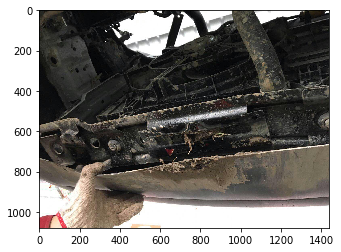

	
36 : 0E2ECF17ED734E8AA979C07D4B7C2E97.jpg
Car_perspective : 0.854624
Others : 0.052479
Car_interior : 0.03327
True Label : Car_human


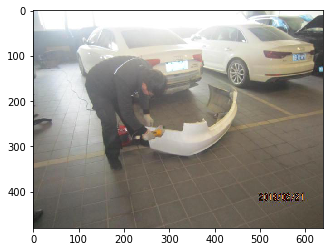

	
37 : 3E4DAAABC4AA4B0B86123C47FB9EAC48.jpg
Trucks : 0.92492
Vin : 0.032748
Car_components : 0.028674
True Label : Car_human


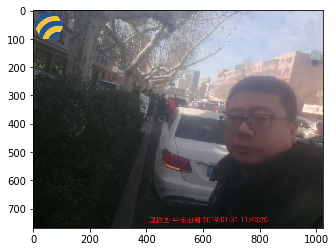

	
38 : 4AB30A0C673745A1932E2DE6C3BA1697.jpg
Trucks : 0.318172
Car_human : 0.252474
Others : 0.1709
True Label : Car_human


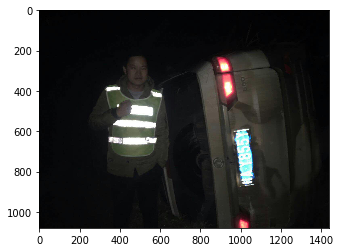

	
39 : 55BBAE7AFC934766A252DF4A18FEA354.jpg
Car_interior : 0.924042
Others : 0.033986
Car_human : 0.014252
True Label : Car_human


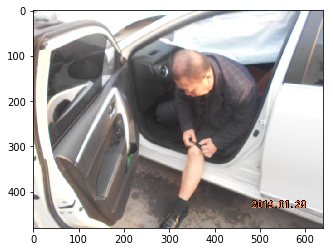

	
40 : 5E6E474FFEBD4901A14182D0B3F20C30.jpg
Car_perspective : 0.827088
Car_human : 0.170901
Trucks : 0.001796
True Label : Car_human


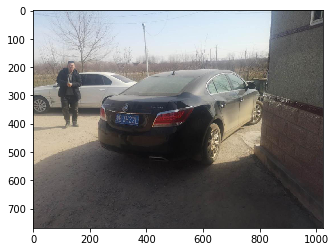

	
41 : 62AA16FD2C6547DC8242CE19EAEA4287.jpg
Car_interior : 0.979513
Car_human : 0.010943
Car_zoom : 0.006407
True Label : Car_human


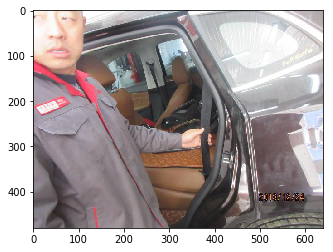

	
42 : 7A5AAF82FDE9427DBE6487A8D20E91FC.jpg
Trucks : 0.971036
Car_human : 0.026869
Car_perspective : 0.001145
True Label : Car_human


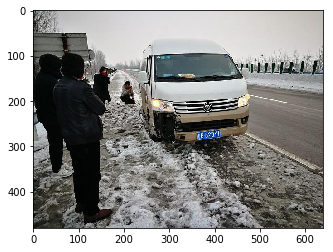

	
43 : 8F7F2B5AEF5F475889811FAF6BDFE123.jpg
Car_interior : 0.999878
Car_components : 8.3e-05
Wheels : 2.8e-05
True Label : Car_human


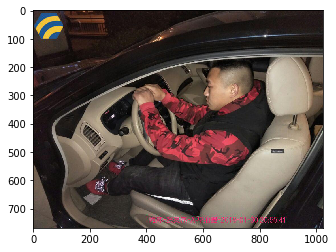

	
44 : 9B075B51819049C5B3331703E44DD9EA.jpg
Trucks : 0.765577
Car_human : 0.234397
Car_components : 1.2e-05
True Label : Car_human


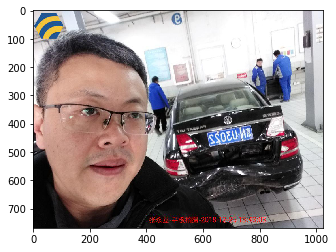

	
45 : A713DFD28D0049BBBA77CEBEB6B4A9E3.jpg
Trucks : 0.969339
Car_human : 0.030552
Car_components : 4.5e-05
True Label : Car_human


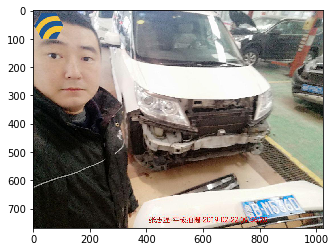

	
46 : A79B4804B75543C8BE7837363B55F103.jpg
Car_perspective : 0.953203
Car_human : 0.044801
Car_zoom : 0.001235
True Label : Car_human


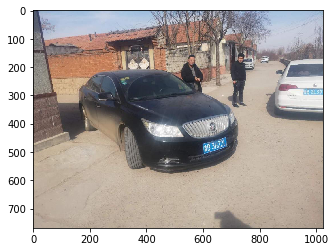

	
47 : AEE95DC653AE45818B4C45D5639317EC.jpg
Trucks : 0.996662
Car_human : 0.003327
Others : 1e-05
True Label : Car_human


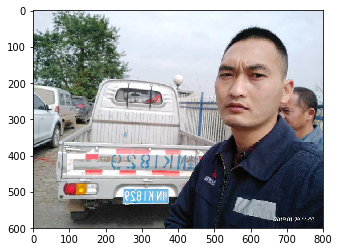

	
48 : C022064A5A8B4AAC87D9D63312C57B04.jpg
Car_interior : 0.464758
Trucks : 0.312188
Car_human : 0.176307
True Label : Car_human


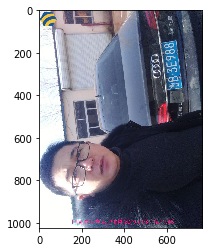

	
49 : C659DC8A306A4F92AD687DD3C5DCD49A.jpg
Trucks : 0.625085
Car_human : 0.373761
Car_zoom : 0.000628
True Label : Car_human


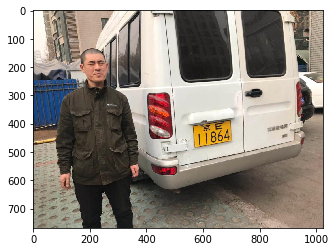

	
50 : C7C95A65CCBC4AC6ABF66C86423EB3FF.jpg
Car_zoom : 0.874525
Car_perspective : 0.03062
Car_components : 0.029793
True Label : Car_human


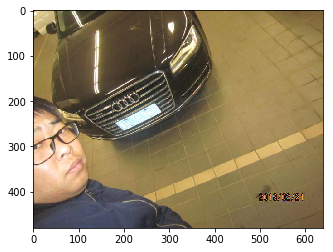

	
51 : 0FFCC9C8AAFB45079FA2591100DE6B58.jpg
Car_components : 0.926072
Car_interior : 0.069985
Trucks : 0.001943
True Label : Car_interior


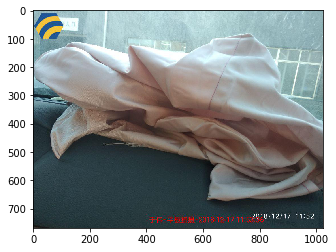

	
52 : 5D604FEE445741039C33DAB2435FC16C.jpg
Car_components : 0.635731
Car_zoom : 0.33627
Car_interior : 0.014569
True Label : Car_interior


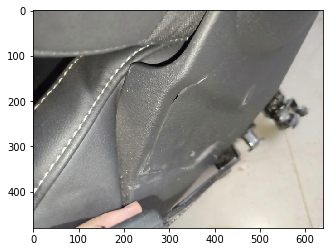

	
53 : 82441D14947244A2A9E0EDDAC97B2F1A.jpg
Car_components : 0.877696
Car_interior : 0.11465
Wheels : 0.003224
True Label : Car_interior


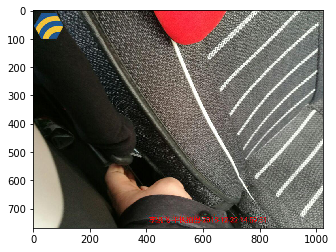

	
54 : 001F0CE0917D465D88386A3B0B5682A1.jpg
Trucks : 0.515938
Wheels : 0.161595
Car_zoom : 0.148318
True Label : Car_perspective


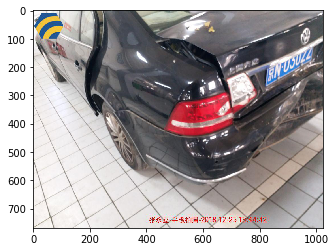

	
55 : 0FDD7AF325104440A03FB2035FB83539.jpg
Trucks : 0.90206
Car_perspective : 0.072773
Car_human : 0.0115
True Label : Car_perspective


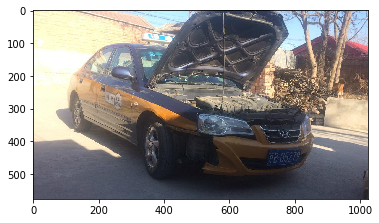

	
56 : 1179BC5683F0482D974BF67F37CFA78E.jpg
Car_interior : 0.96149
Car_components : 0.026951
Trucks : 0.005915
True Label : Car_perspective


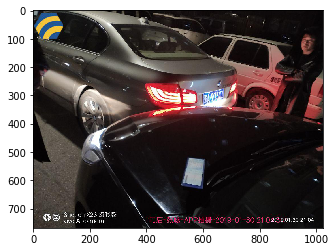

	
57 : 245EBED31D6A425999D12BDC8D90676C.jpg
Car_zoom : 0.880138
Car_perspective : 0.076025
Trucks : 0.03582
True Label : Car_perspective


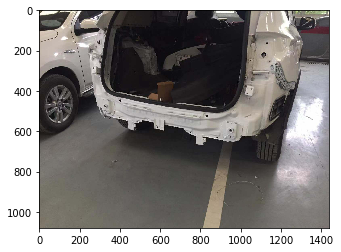

	
58 : 28F9DC0826564D049E855CC91BBAFEFD.jpg
Trucks : 0.752479
Car_perspective : 0.218901
Car_human : 0.024518
True Label : Car_perspective


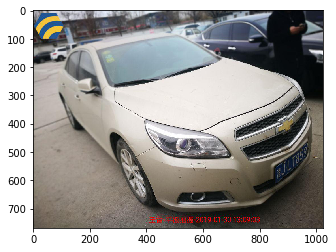

	
59 : 2AB5CB09852E4DE3A3021BF754F246C7.jpg
Car_zoom : 0.919761
Car_components : 0.038597
Car_interior : 0.015506
True Label : Car_perspective


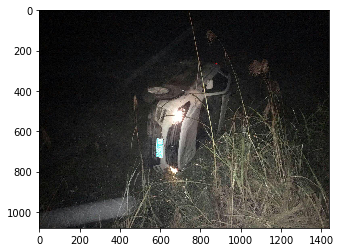

	
60 : 2ECDAD71C25640AA9EAAF5D171B9FE2F.jpg
Trucks : 0.903219
Car_perspective : 0.072395
Vin : 0.01282
True Label : Car_perspective


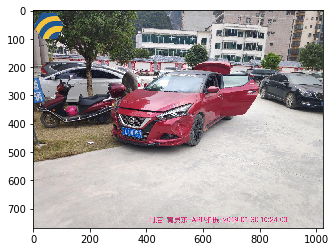

	
61 : 319EB07580034AF2B7B481A9B9B272C2.jpg
Car_human : 0.665612
Car_perspective : 0.317064
Trucks : 0.016093
True Label : Car_perspective


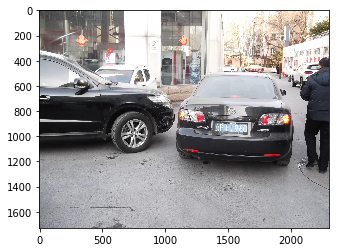

	
62 : 3D75345752244D51AC380E30AC9E3077.jpg
Car_interior : 0.999642
Car_components : 0.000313
Wheels : 2.1e-05
True Label : Car_perspective


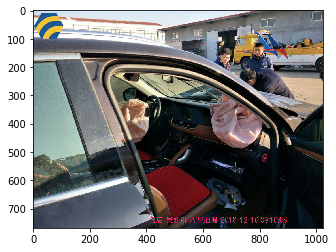

	
63 : 4E0D19F61E9F493982EDB7C28C94D6C5.jpg
Trucks : 0.643981
Car_interior : 0.284979
Car_components : 0.054005
True Label : Car_perspective


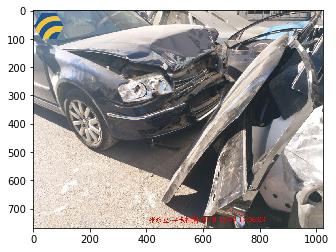

	
64 : 4EDDBC229405454B8F4D0F28E72B3A48.jpg
Trucks : 0.7563
Car_perspective : 0.229107
Car_human : 0.011357
True Label : Car_perspective


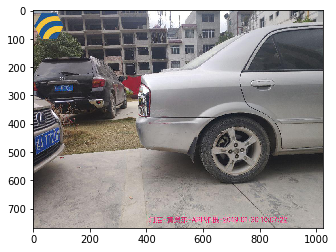

	
65 : 5C6942C699874B198D2EDD7BE3DBAC0D.jpg
Trucks : 0.999961
Car_zoom : 2.3e-05
Car_perspective : 1.4e-05
True Label : Car_perspective


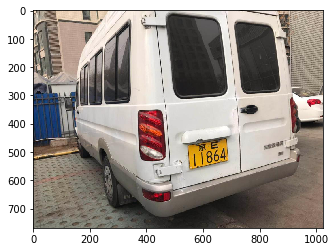

	
66 : 5C8A615C7F2F400F93279F15A3FD7E38.jpg
Car_zoom : 0.662336
Car_perspective : 0.215433
Car_interior : 0.112914
True Label : Car_perspective


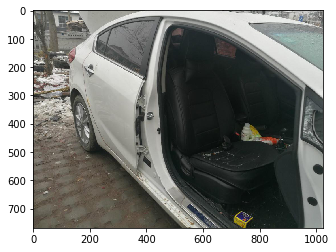

	
67 : 7105D2C2230845A4BC016F475ED28C58.jpg
Car_interior : 0.962749
Car_components : 0.018404
Car_zoom : 0.007852
True Label : Car_perspective


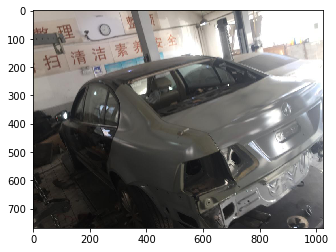

	
68 : 74AF233BF9E84027B6223948299FFEF4.jpg
Trucks : 0.334249
Car_interior : 0.212232
Car_components : 0.147601
True Label : Car_perspective


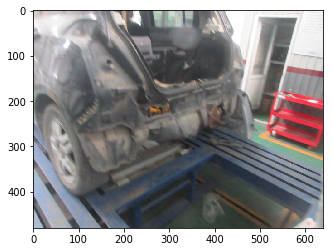

	
69 : A7084B3E80674C7BAC18D4236C24889A.jpg
Trucks : 0.99888
Car_perspective : 0.001001
Car_human : 5e-05
True Label : Car_perspective


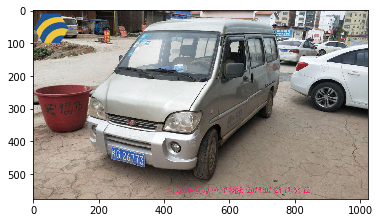

	
70 : BABD3D52179640D0A4FAC8BECA95EECA.jpg
Trucks : 0.794023
Car_perspective : 0.171304
Car_zoom : 0.01252
True Label : Car_perspective


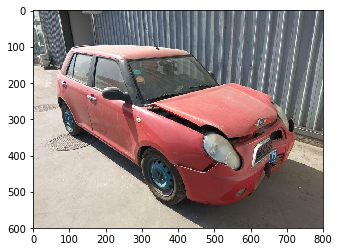

	
71 : BAC78B4EE10147FFA945E8A8456CBD69.jpg
Trucks : 0.952456
Others : 0.022487
Car_perspective : 0.021121
True Label : Car_perspective


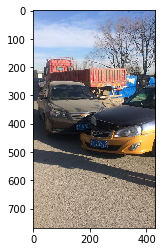

	
72 : C55D298E06E74A38A6D91E98C3DA1288.jpg
Car_human : 0.915192
Car_perspective : 0.082096
Trucks : 0.001993
True Label : Car_perspective


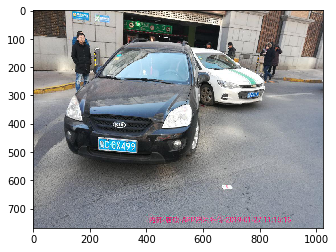

	
73 : E36194512F6849ECAE7C0BEFB80DA47B.jpg
Trucks : 0.677171
Car_perspective : 0.297877
Car_human : 0.018537
True Label : Car_perspective


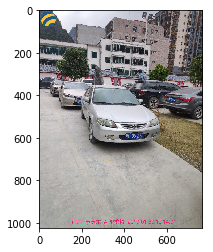

	
74 : F126A4B8C7794C659E12668E0F4C3D6F.jpg
Car_interior : 0.3972
Trucks : 0.316846
Car_components : 0.069301
True Label : Car_perspective


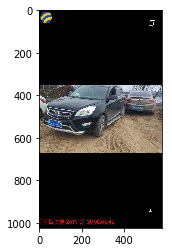

	
75 : F8C4B3479F5B4647A7504F2C7443E089.jpg
Trucks : 0.719424
Car_interior : 0.119711
Car_components : 0.08739
True Label : Car_perspective


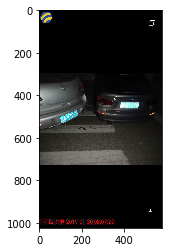

	
76 : FD7046C60FC141BFAD9BE3C471258ED1.jpg
Trucks : 0.941318
Car_perspective : 0.053886
Car_human : 0.002135
True Label : Car_perspective


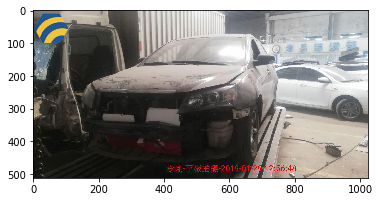

	
77 : 052A3D5A5BF74AC592005B1B341FE2B7.jpg
Trucks : 0.872834
Car_components : 0.115211
Car_interior : 0.003549
True Label : Car_zoom


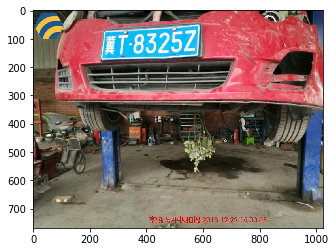

	
78 : 085385ECA543451E9BB3030106FD2FC0.jpg
Car_interior : 0.555428
Trucks : 0.173233
Car_perspective : 0.098736
True Label : Car_zoom


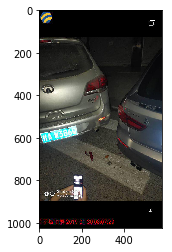

	
79 : 0A08A2664CD349A1B980570770394F82.jpg
Wheels : 0.638427
Car_zoom : 0.168129
Car_components : 0.11456
True Label : Car_zoom


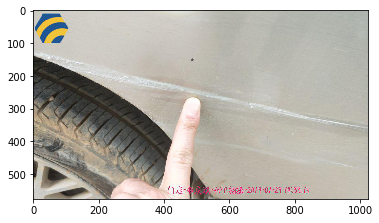

	
80 : 0B70F5AA4F2E44D499221F59C308F1A0.jpg
Car_perspective : 0.785902
Car_zoom : 0.169005
Trucks : 0.016876
True Label : Car_zoom


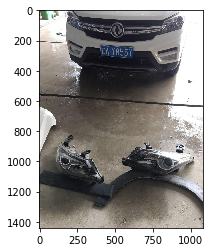

	
81 : 0C1389626C36400398D7BC54D56CC19B.jpg
Trucks : 0.707004
Car_zoom : 0.288718
Wheels : 0.00304
True Label : Car_zoom


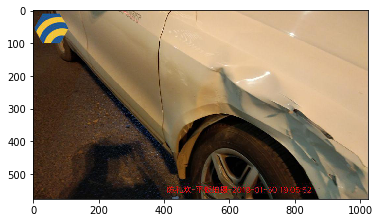

	
82 : 10360DEC750444B0846E6E6069ED673A.jpg
Trucks : 0.515153
Car_zoom : 0.460847
Car_components : 0.018566
True Label : Car_zoom


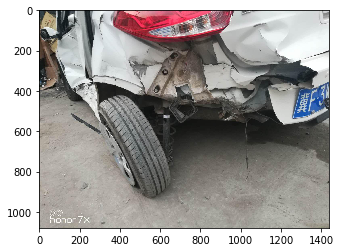

	
83 : 161-5E783E23-D945-DAA7-E793-3C9B8E1E68CA.png
Trucks : 0.747122
Car_zoom : 0.249477
Others : 0.001974
True Label : Car_zoom


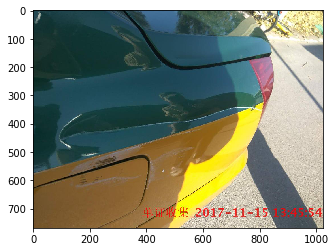

	
84 : 1870DE2E3A204E3C9326EDB067173DA9.jpg
Trucks : 0.876931
Wheels : 0.061334
Car_interior : 0.029395
True Label : Car_zoom


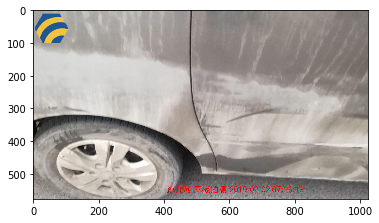

	
85 : 1972D71824AB49199BEFF4CAA5247F64.jpg
Wheels : 0.344732
Car_zoom : 0.224166
Trucks : 0.144771
True Label : Car_zoom


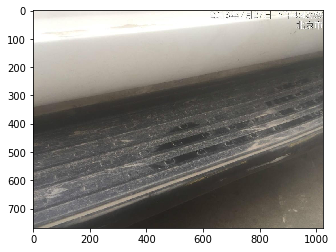

	
86 : 1B6E7D6896FF4A89B00AB83C32A8CCC5.jpg
Car_interior : 0.893425
Wheels : 0.053667
Car_zoom : 0.051007
True Label : Car_zoom


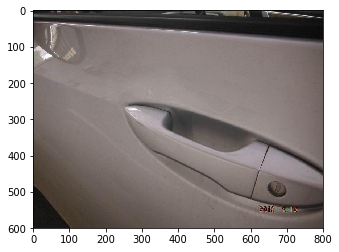

	
87 : 1BBDFA2D98E74637AD9F425CD6DC6801.jpg
Car_interior : 0.61245
Car_zoom : 0.197731
Car_components : 0.118004
True Label : Car_zoom


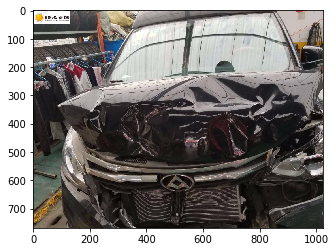

	
88 : 1DA72D6D797C45129ACFDDA0E3F1AF85.jpg
Trucks : 0.978835
Car_components : 0.00824
Car_zoom : 0.006593
True Label : Car_zoom


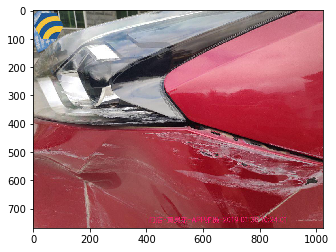

	
89 : 2D4FC3C65E2D42A5B927DB9E6748D713.jpg
Car_components : 0.622653
Trucks : 0.368878
Car_zoom : 0.005507
True Label : Car_zoom


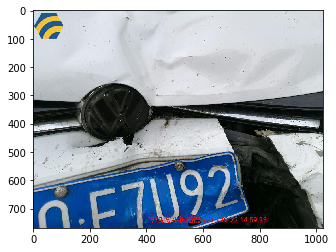

	
90 : 31681FEA13544417873262A182524365.jpg
Trucks : 0.99956
Car_components : 0.00031
Car_zoom : 8.6e-05
True Label : Car_zoom


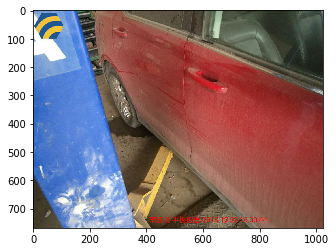

	
91 : 3B22225817B546109E3CE9159454BE61.jpg
Trucks : 0.53929
Car_zoom : 0.356695
Car_perspective : 0.047774
True Label : Car_zoom


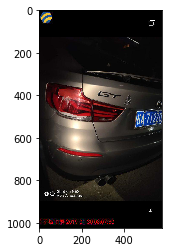

	
92 : 41763F497781484595A4263B31C059D6.jpg
Car_interior : 0.707538
Car_zoom : 0.156919
Car_components : 0.107222
True Label : Car_zoom


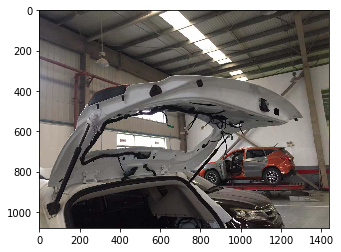

	
93 : 4C543C5D3E5B423EA996862C7B710F01.jpg
Car_interior : 0.277116
Trucks : 0.224465
Car_zoom : 0.150322
True Label : Car_zoom


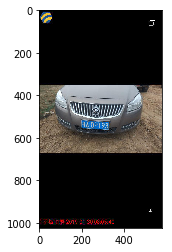

	
94 : 51620DCE71BD4C588F28B16991D03492.jpg
Car_perspective : 0.711158
Others : 0.187676
Trucks : 0.040046
True Label : Car_zoom


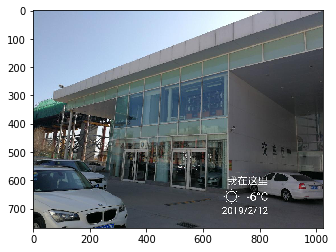

	
95 : 52587D7378BA42498E3C2F3312F95854.jpg
Wheels : 0.99917
Trucks : 0.000765
Car_interior : 2.2e-05
True Label : Car_zoom


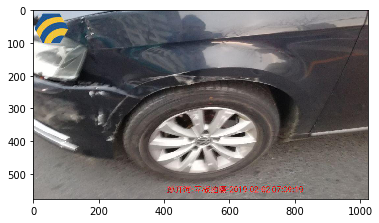

	
96 : 5BC4416EB81148A297A70EB021BF2FDD.jpg
Car_interior : 0.489353
Car_zoom : 0.421984
Car_components : 0.064511
True Label : Car_zoom


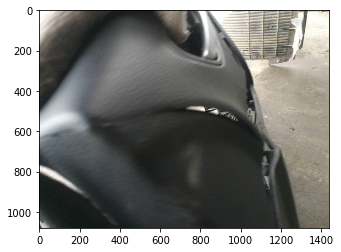

	
97 : 62E0FB77F8C449C0BE1CD7B090213FBC.jpg
Car_interior : 0.872083
Car_zoom : 0.087577
Car_components : 0.031017
True Label : Car_zoom


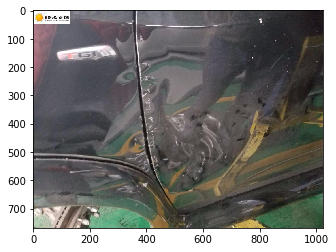

	
98 : 83112AA39CB84622A1E6E056C365FD95.jpg
Car_perspective : 0.848638
Trucks : 0.122367
Car_human : 0.015429
True Label : Car_zoom


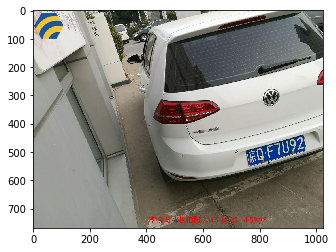

	
99 : 8AECB2FDAD4B4241AAD57C435CCCAB52.jpg
Trucks : 0.540338
Car_zoom : 0.343274
Car_components : 0.101527
True Label : Car_zoom


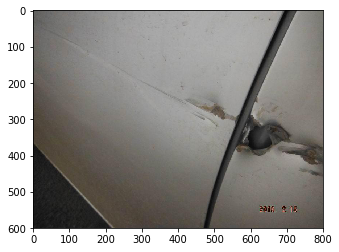

	
100 : 97D6C3C93D7740F6B04D273E1A9AA7A1.jpg
Car_components : 0.517499
Car_zoom : 0.408279
Wheels : 0.051124
True Label : Car_zoom


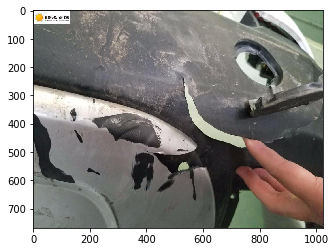

	
101 : 9EA97CE7CFE444B091FE013C9D408B91.jpg
Car_perspective : 0.673176
Car_zoom : 0.308193
Trucks : 0.012117
True Label : Car_zoom


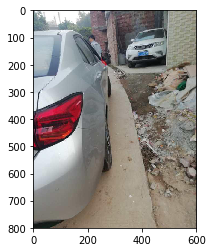

	
102 : A68BF62CDF2847F5AD0A11BE4C6530F7.jpg
Trucks : 0.643056
Car_zoom : 0.182865
Car_interior : 0.129772
True Label : Car_zoom


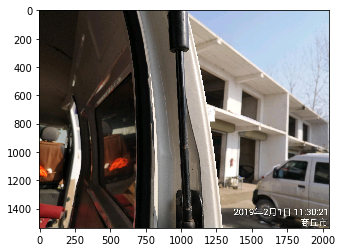

	
103 : B858210D56EE4E07A1A5F49FCDA27DDB.jpg
Car_interior : 0.647576
Trucks : 0.322849
Car_zoom : 0.023594
True Label : Car_zoom


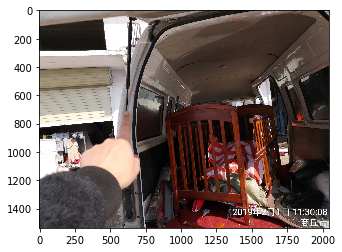

	
104 : B8588EDCFD074ECDB9C7EB31D212B9CF.jpg
Wheels : 0.995227
Car_zoom : 0.004348
Trucks : 0.00022
True Label : Car_zoom


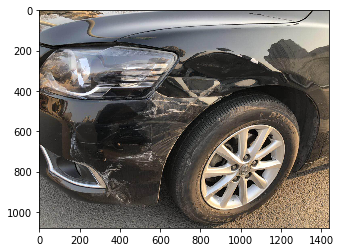

	
105 : BA04924B77D844FF8AE9B39F68F7B2B8.jpg
Car_perspective : 0.820377
Car_zoom : 0.172351
Trucks : 0.004409
True Label : Car_zoom


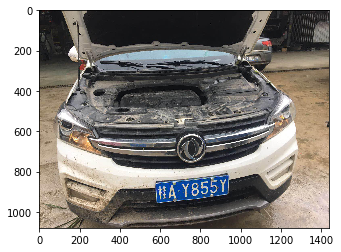

	
106 : BFA26FC9A38D4D738006FB42E4B7D708.jpg
Trucks : 0.668264
Car_components : 0.242139
Car_zoom : 0.044561
True Label : Car_zoom


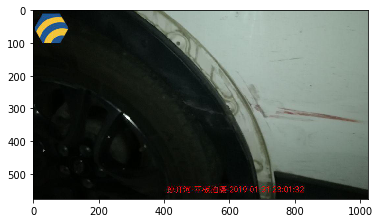

	
107 : CC93D72D51C54BE1B776ECA70417243E.jpg
Car_interior : 0.551082
Trucks : 0.254501
Car_perspective : 0.118296
True Label : Car_zoom


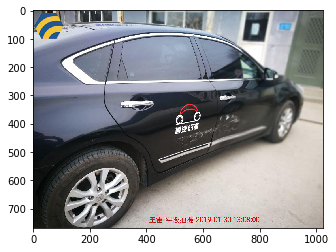

	
108 : E346D10416ED4B1DAE0A4CDA0DE37134.jpg
Car_perspective : 0.967349
Car_zoom : 0.030681
Car_human : 0.001097
True Label : Car_zoom


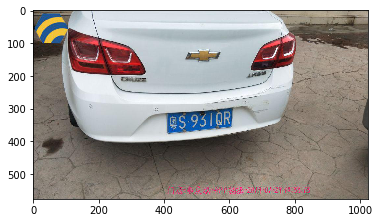

	
109 : EB9F50E940D64293957A304E04EC4EB0.jpg
Trucks : 0.975377
Car_zoom : 0.023095
Others : 0.000827
True Label : Car_zoom


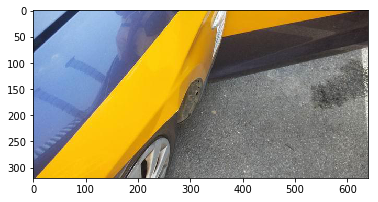

	
110 : F9342C7ADAF9452388F58DBE2218035F.jpg
Wheels : 0.93659
Car_zoom : 0.060719
Car_components : 0.001001
True Label : Car_zoom


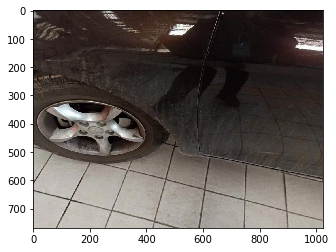

	
111 : FCD214A210E54C1F865B63E21BCB155B.jpg
Car_interior : 0.542151
Car_components : 0.166592
Car_zoom : 0.115624
True Label : Car_zoom


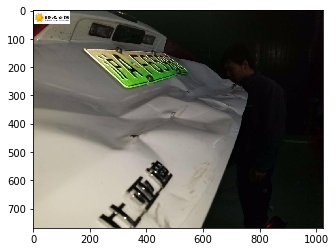

	
112 : 31589020FAD94FE296E8EBD057FC6EF9.jpg
Car_interior : 0.94186
Car_components : 0.030438
Documents : 0.015113
True Label : Documents


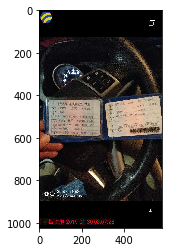

	
113 : 63632D49519E445A8487BAFD133702ED.jpg
Trucks : 0.566019
Car_interior : 0.172159
Car_human : 0.165403
True Label : Documents


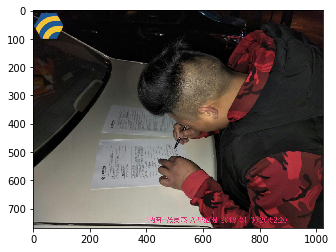

	
114 : 8F11A56400C54EF6B2A934115686952D.jpg
Vin : 0.534854
Documents : 0.352245
Others : 0.112092
True Label : Documents


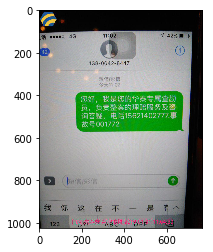

	
115 : E762AEE92F594716B38CD95D2060B769.jpg
Others : 0.994957
Documents : 0.004887
Car_interior : 0.000128
True Label : Documents


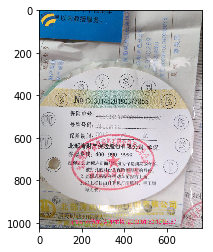

	
116 : 01A305B9515F438E87517779E9E6B5C8.jpg
Car_human : 0.743812
Trucks : 0.172975
Car_interior : 0.02469
True Label : Others


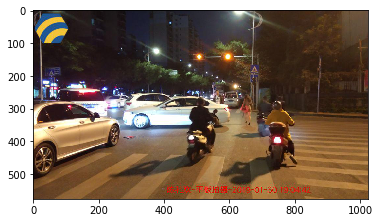

	
117 : 0511204F62BE4AE38087ADCF3A536705.jpg
Trucks : 0.89436
Car_components : 0.099161
Others : 0.003554
True Label : Others


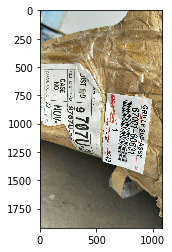

	
118 : 05B695628BBC4AC2B196F98F4F87640C.jpg
Car_perspective : 0.418681
Car_zoom : 0.252131
Car_human : 0.214304
True Label : Others


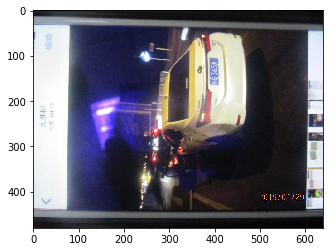

	
119 : 0FAC6CBD06BE48A786C4EC6980028B6C.jpg
Trucks : 0.496579
Car_perspective : 0.483716
Car_human : 0.011412
True Label : Others


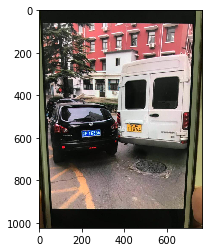

	
120 : 11585F9382E04408BCA9A17C85970840.jpg
Trucks : 0.497477
Car_perspective : 0.360066
Others : 0.061096
True Label : Others


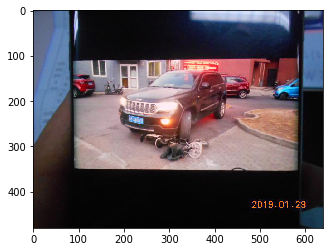

	
121 : 161-44111890-98CE-AEB7-13BC-C6B0AE071AC1.jpg
Documents : 0.361638
Car_zoom : 0.340445
Others : 0.102147
True Label : Others


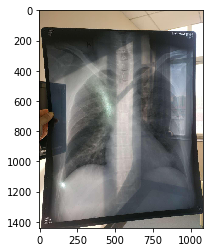

	
122 : 161-A2D335A5-B392-C263-59DC-2A3CAF99D49E.jpg
Car_components : 0.514952
Car_zoom : 0.218527
Others : 0.151221
True Label : Others


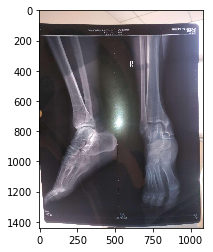

	
123 : 1A7A04AE34394C6CA423E1827EFD5450.jpg
Trucks : 0.575062
Car_components : 0.343537
Others : 0.066639
True Label : Others


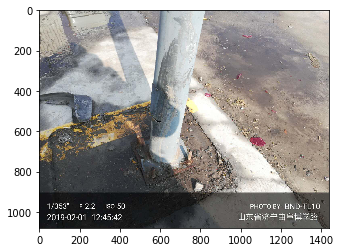

	
124 : 1BF6430215C34649AA65C9CE6C72A1DD.jpg
Car_perspective : 0.946442
Car_human : 0.034178
Trucks : 0.00829
True Label : Others


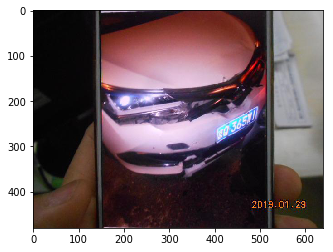

	
125 : 1F21B579D3B445D2B37E3B6205AAF1DE.jpg
Car_perspective : 0.730261
Car_human : 0.117416
Trucks : 0.072487
True Label : Others


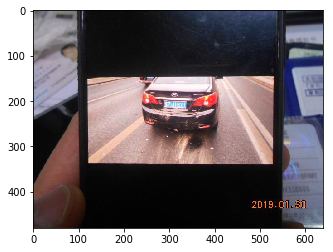

	
126 : 202FF73F75384D5DAFA509559FF59B04.jpg
Vin : 0.483026
Others : 0.252326
Documents : 0.215238
True Label : Others


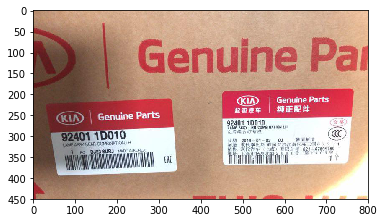

	
127 : 22BEEBFA10834E73A46CAA79B06C983A.jpg
Car_interior : 0.758741
Car_components : 0.191192
Others : 0.037264
True Label : Others


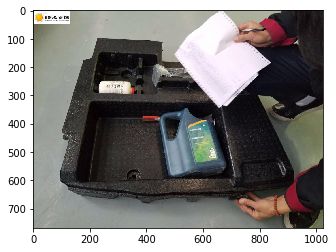

	
128 : 253FA069A7A8415E9E985D66339D5D23.jpg
Trucks : 0.777423
Car_perspective : 0.122967
Car_human : 0.05049
True Label : Others


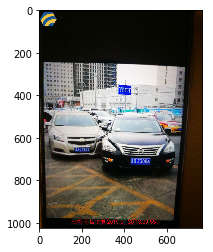

	
129 : 2DCE3CB50FB64BC39079996A98AC23C6.jpg
Car_interior : 0.371422
Trucks : 0.244079
Car_components : 0.110969
True Label : Others


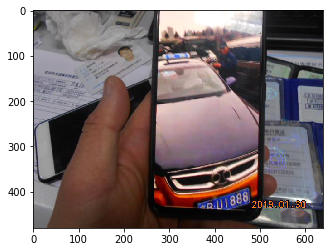

	
130 : 3A1C41C3BF6A441FBE1FC03718215104.jpg
Car_zoom : 0.47636
Car_components : 0.317406
Others : 0.07055
True Label : Others


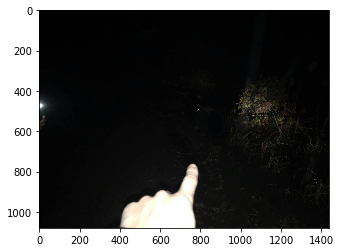

	
131 : 6456578A15E9432EBBFFBC8F79B47D50.jpg
Trucks : 0.586346
Vin : 0.292227
Car_components : 0.043694
True Label : Others


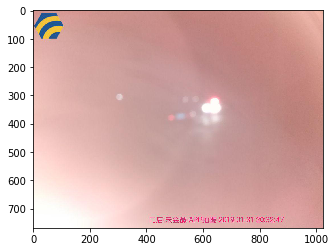

	
132 : 68CDB108A8BE42019E0D5A70B157D7A0.jpg
Car_components : 0.942626
Car_zoom : 0.047578
Others : 0.006135
True Label : Others


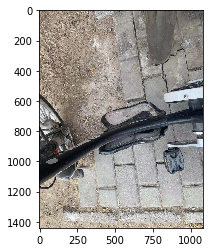

	
133 : 78FB4CC34D554CCCAEB8F7CC9E1CB8BB.jpg
Car_zoom : 0.557541
Car_components : 0.323822
Trucks : 0.041179
True Label : Others


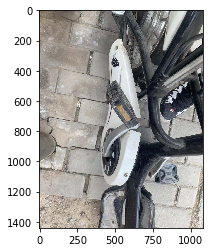

	
134 : 7D4C942DDF3F4458B720964828C3657B.png
Documents : 0.933822
Others : 0.064273
Car_zoom : 0.000738
True Label : Others


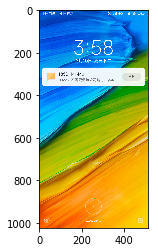

	
135 : 7E007C0DAFC24B78B0E9B103C551B07D.jpg
Vin : 0.670244
Others : 0.15504
Trucks : 0.058281
True Label : Others


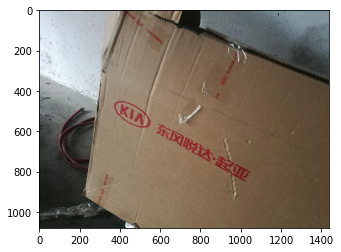

	
136 : 82E7B63785E3465CA7E0BF6932101041.jpg
Car_components : 0.56827
Car_zoom : 0.194093
Others : 0.187247
True Label : Others


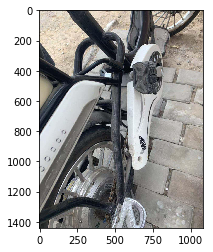

	
137 : 8ED7F7006CBE4E1DA2E1CBDB9770873B.jpg
Vin : 0.503274
Car_components : 0.212369
Car_zoom : 0.200968
True Label : Others


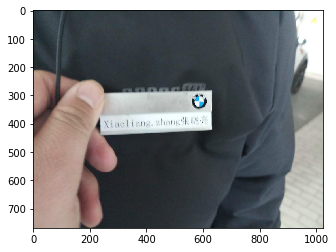

	
138 : A3B4481615CB456DAE260326D642F992.jpg
Car_perspective : 0.988197
Car_human : 0.003195
Car_zoom : 0.002688
True Label : Others


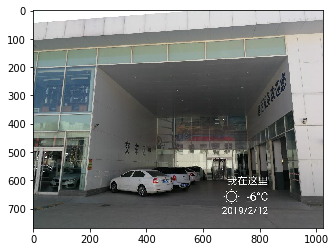

	
139 : A509DB8F5048464BBDBA833580460419.jpg
Documents : 0.700111
Others : 0.224705
Car_zoom : 0.041028
True Label : Others


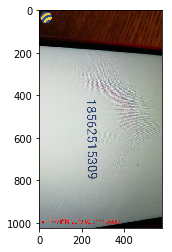

	
140 : ACDFEB3A7ABA400B865525E4BFCBD5E1.jpg
Car_components : 0.734202
Others : 0.205769
Car_zoom : 0.02577
True Label : Others


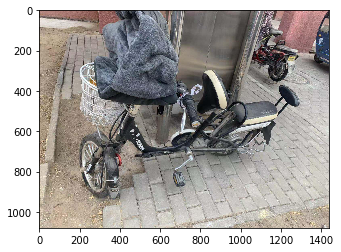

	
141 : B99F570387134474BD069DD13B4AABD5.jpg
Car_zoom : 0.261126
Others : 0.221293
Trucks : 0.180247
True Label : Others


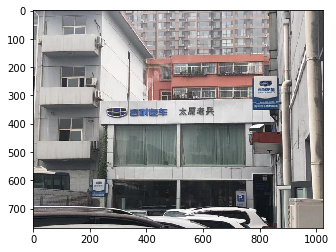

	
142 : BDC08403DAA846A0AE7E965F35AB1D2B.jpg
Car_interior : 0.901003
Others : 0.035144
Car_components : 0.031142
True Label : Others


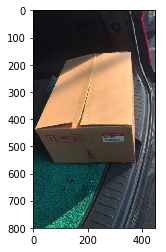

	
143 : BE39B451F0344A6EB8230088F27AA621.jpg
Trucks : 0.620007
Car_components : 0.337899
Others : 0.022592
True Label : Others


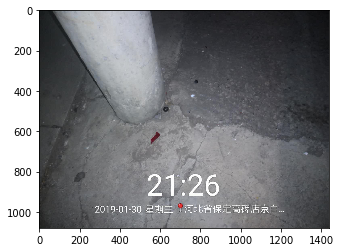

	
144 : BFEF8F2DB4D3478BA8206AAB4753BD18.jpg
Trucks : 0.735893
Car_interior : 0.210632
Car_human : 0.025954
True Label : Others


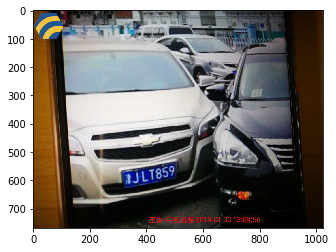

	
145 : C304ACEE8DBB47FA95DF41E539627957.jpg
Car_perspective : 0.429077
Car_zoom : 0.284453
Trucks : 0.208505
True Label : Others


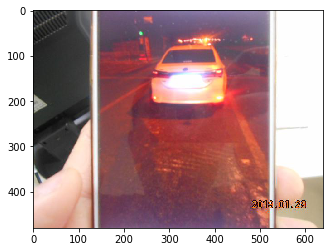

	
146 : CAC1C08CAD004AE889576D83A4647BD0.jpg
Documents : 0.6414
Others : 0.357304
Car_zoom : 0.000356
True Label : Others


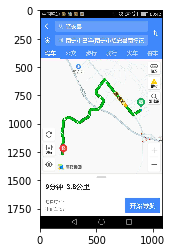

	
147 : E39D26A18CF741AE846B000DDA65FC6F.jpg
Car_interior : 0.423618
Trucks : 0.217004
Others : 0.197023
True Label : Others


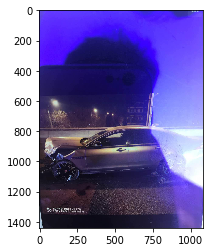

	
148 : F77080FD7B4F4758AD2803CB0BB39A2F.jpg
Car_interior : 0.912634
Car_zoom : 0.045223
Car_components : 0.01922
True Label : Others


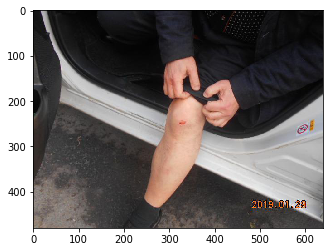

	
149 : FD5DFEA906D54C7FB045A813AD47FBD8.jpg
Trucks : 0.97231
Car_components : 0.020605
Others : 0.005025
True Label : Others


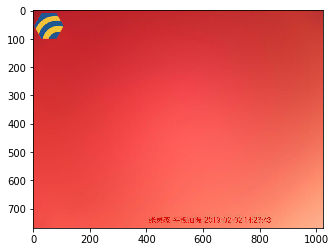

	
150 : FF1549D37A984CF698120811A536621B.jpg
Car_zoom : 0.988879
Trucks : 0.010292
Others : 0.000257
True Label : Others


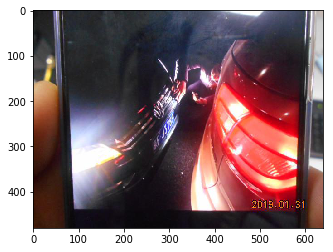

	
151 : FF74508862EE41889D910D5F30FFFF39.jpg
Documents : 0.996376
Others : 0.003623
Car_zoom : 1e-06
True Label : Others


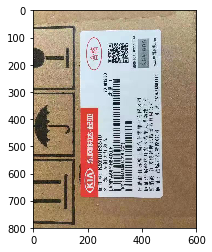

	
152 : 0E3DD2B3E0AE435CB333DA9DC9AC0C47.jpg
Car_zoom : 0.451967
Trucks : 0.332691
Car_interior : 0.152323
True Label : Trucks


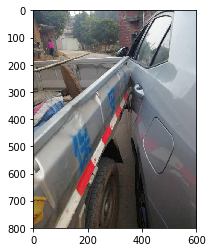

	
153 : 35EC87AE7D5340EAA4576CCB08ED9F66.jpg
Car_perspective : 0.995124
Trucks : 0.002361
Car_human : 0.001632
True Label : Trucks


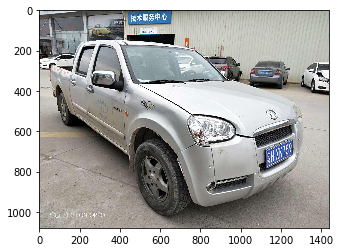

	
154 : 446B7972D7834354850B151590967D78.jpg
Car_zoom : 0.320074
Car_interior : 0.238758
Trucks : 0.217274
True Label : Trucks


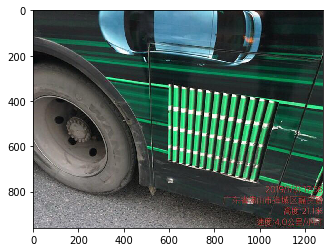

	
155 : 5B19EC6215A44F94A793DE02CA0336EC.jpg
Car_human : 0.787289
Trucks : 0.212103
Car_zoom : 0.000213
True Label : Trucks


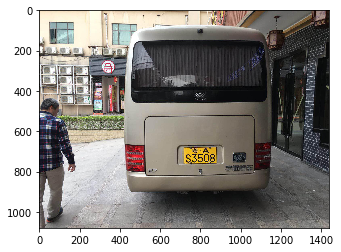

	
156 : 68E609274AD4416CB1FEF9B054CB3F80.jpg
Car_perspective : 0.995816
Trucks : 0.003238
Car_human : 0.000528
True Label : Trucks


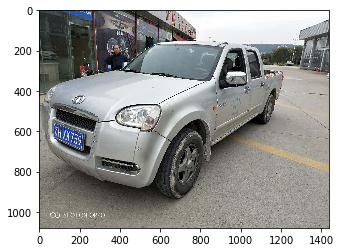

	
157 : B14019A2DC13487A9413C06B4DD7F6A9.jpg
Car_zoom : 0.952574
Car_perspective : 0.041726
Trucks : 0.004419
True Label : Trucks


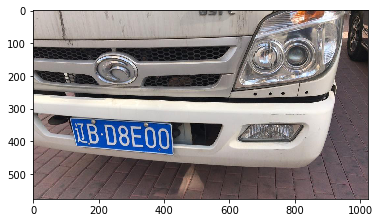

	
158 : C48983A7B2BA42F080ECC9366F75575F.jpg
Car_interior : 0.332318
Trucks : 0.222319
Car_zoom : 0.217553
True Label : Trucks


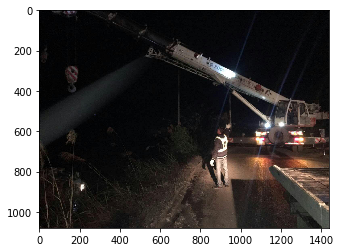

	
159 : C9714F52361A41DD9F966932D355C399.jpg
Car_zoom : 0.713244
Trucks : 0.249596
Car_components : 0.013605
True Label : Trucks


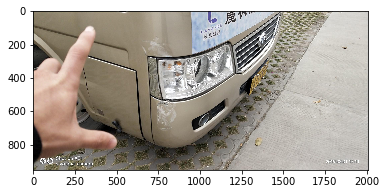

	
160 : CC6B539FDC574A93BB53830A4CC53A56.jpg
Car_zoom : 0.728541
Wheels : 0.267881
Car_components : 0.00192
True Label : Trucks


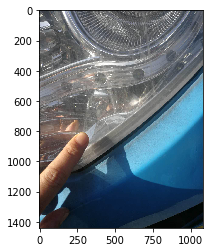

	
161 : DBA7D0309686423D804E5785E42F156B.jpg
Car_zoom : 0.861889
Trucks : 0.119987
Others : 0.009355
True Label : Trucks


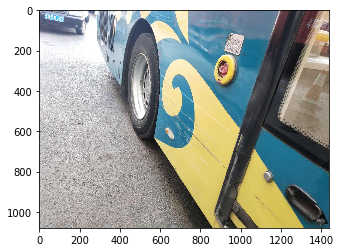

	
162 : DC00744B829448B0B8470BC3BED799D9.jpg
Others : 0.9407
Car_zoom : 0.021857
Trucks : 0.018206
True Label : Trucks


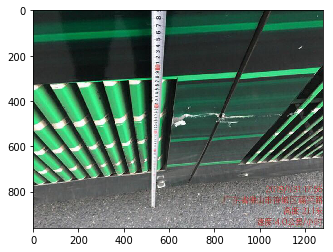

	
163 : F065158B6B454ABCB0C3304262B4E430.jpg
Car_interior : 0.933309
Trucks : 0.05781
Others : 0.004592
True Label : Trucks


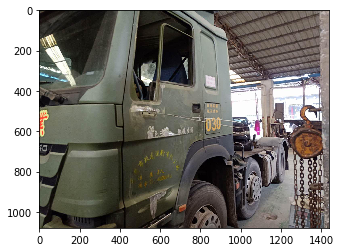

	
164 : F099CE0D582F4CBB8C36EB0AF6E5A218.jpg
Car_zoom : 0.825442
Trucks : 0.068111
Others : 0.067204
True Label : Trucks


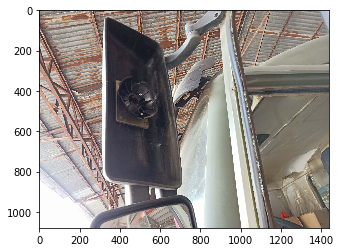

	
165 : FF9DF76E817942C5BD14DCF30FA13978.jpg
Car_zoom : 0.991584
Trucks : 0.006363
Car_perspective : 0.001328
True Label : Trucks


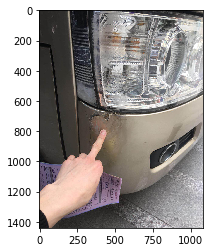

	
166 : 74A3CA0B450946DA915BF0429FEE9ED8.jpg
Car_components : 0.628019
Vin : 0.257638
Car_interior : 0.054175
True Label : Vin


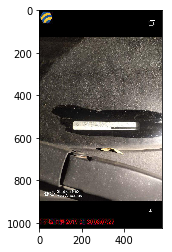

	
167 : D0469B36B1684B648A827413417629D1.jpg
Car_interior : 0.66733
Car_components : 0.133035
Car_zoom : 0.10564
True Label : Vin


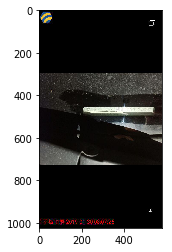

	
168 : 09181696F12048A2930C6DCE4C58B56D.jpg
Car_zoom : 0.997559
Wheels : 0.001384
Trucks : 0.001038
True Label : Wheels


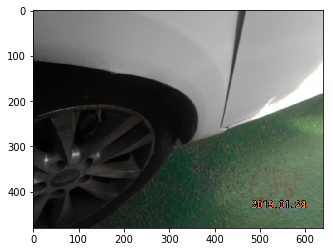

	
169 : 13A82B0D7EBA4452B2AC774213B9DAE1.jpg
Car_zoom : 0.680837
Trucks : 0.177165
Wheels : 0.079027
True Label : Wheels


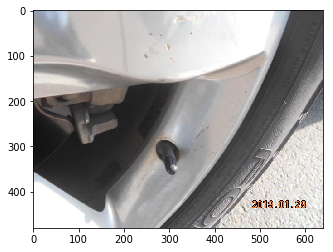

	
170 : 161-3628F6AD-B858-0A91-3E5B-DFFC20DB5138.png
Trucks : 0.992925
Car_zoom : 0.004484
Wheels : 0.002214
True Label : Wheels


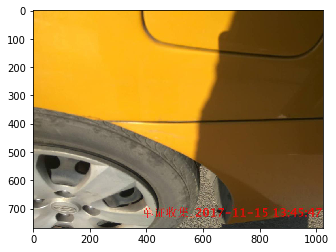

	
171 : 1BA2CCF6165645FF8D744A422E846A1E.jpg
Car_zoom : 0.611117
Wheels : 0.228812
Car_perspective : 0.059289
True Label : Wheels


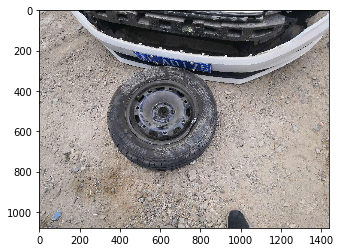

	
172 : 8D37E9AE2AC641C299866109987DB8D2.jpg
Trucks : 0.479635
Car_components : 0.246547
Wheels : 0.201084
True Label : Wheels


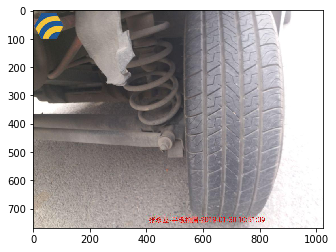

	
173 : F52D5E5978CA4D01AF4DB9F3F31E827E.jpg
Trucks : 0.507646
Car_components : 0.469951
Wheels : 0.01501
True Label : Wheels


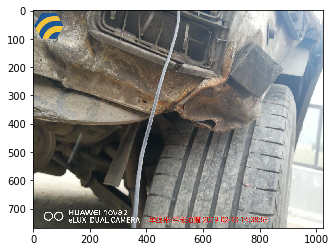

	
174 : FDAEA762BB0F4C41852866DD120409EA.jpg
Car_components : 0.885809
Trucks : 0.106951
Wheels : 0.003966
True Label : Wheels


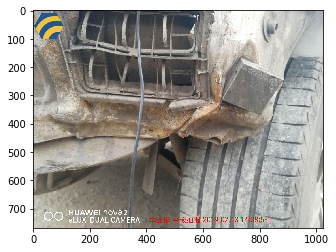

In [17]:
for idx, j in enumerate(wrg_index):
    try:
        file_name = test_set_df.loc[j,'filename'].split("\\")[-1]
        print(idx+1, ':', file_name)    
        for c in np.argsort(-y_preds[j])[:3]:
            print(classes[c],':', np.round(y_preds[j][c], decimals=6))
        print('True Label',':', classes[test_set_df.loc[j,'category']])
        img_array = plt.imread(test_set_df.loc[j,'filename'])
        plt.imshow(img_array)  
        plt.show()
        print('\t')
    except:
        continue

Confusion matrix, without normalization
[[ 94   1   0  15   1   6   2   6   3   1]
 [  0 117   0   1   0   0   1   1   1   0]
 [  0   0  86   4   3   1   0   7   0   0]
 [  3   0   0  58   0   0   0   0   0   0]
 [  0   0   2   4  94   3   0  14   0   0]
 [  2   0   0  10   6  61   0  12   0   5]
 [  4   5   1   5   5   4  35   9   3   0]
 [  0   0   1   2   2   8   1  82   0   0]
 [  1   0   0   1   0   0   0   0  99   0]
 [  1   0   0   0   0   3   0   3   0  86]]


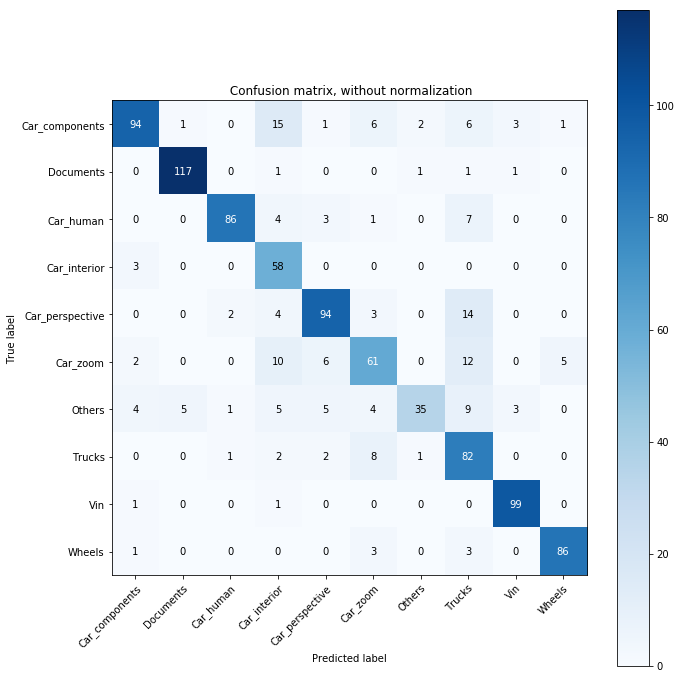

Normalized confusion matrix
[[0.73 0.01 0.   0.12 0.01 0.05 0.02 0.05 0.02 0.01]
 [0.   0.97 0.   0.01 0.   0.   0.01 0.01 0.01 0.  ]
 [0.   0.   0.85 0.04 0.03 0.01 0.   0.07 0.   0.  ]
 [0.05 0.   0.   0.95 0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.02 0.03 0.8  0.03 0.   0.12 0.   0.  ]
 [0.02 0.   0.   0.1  0.06 0.64 0.   0.12 0.   0.05]
 [0.06 0.07 0.01 0.07 0.07 0.06 0.49 0.13 0.04 0.  ]
 [0.   0.   0.01 0.02 0.02 0.08 0.01 0.85 0.   0.  ]
 [0.01 0.   0.   0.01 0.   0.   0.   0.   0.98 0.  ]
 [0.01 0.   0.   0.   0.   0.03 0.   0.03 0.   0.92]]


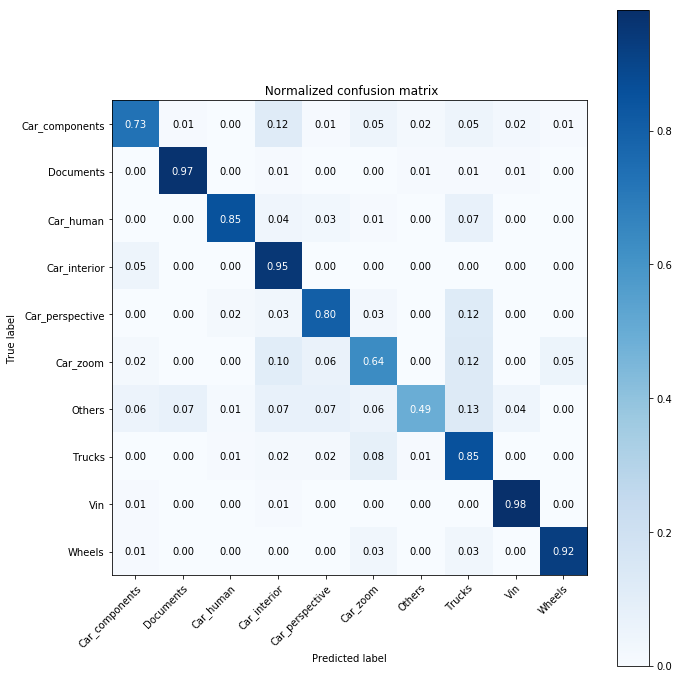

In [14]:
# sav = r"C:\Users\yga\PycharmProjects\zoom_image_classifier\csv_files"
conf_matrix(test_set_df['category'].to_list(), test_set_df['prediction'].to_list(), fig_save_path)

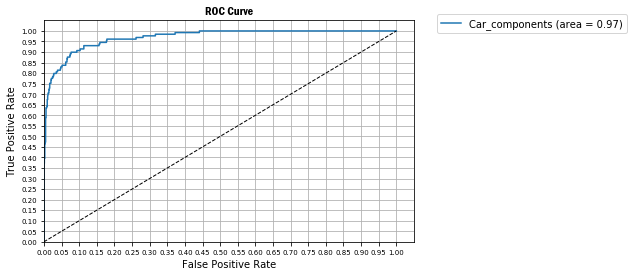

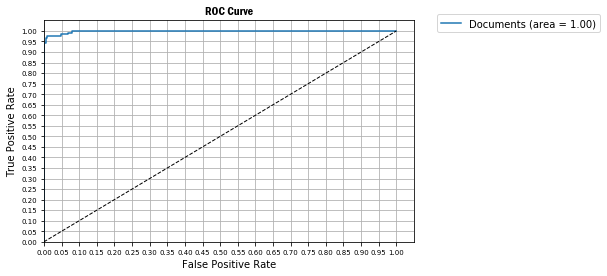

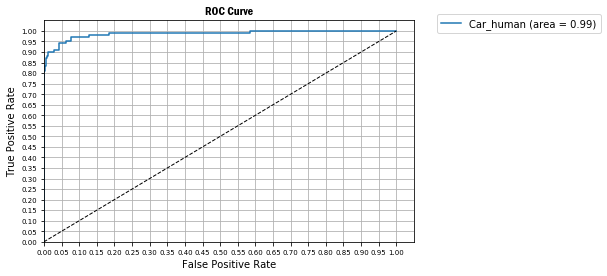

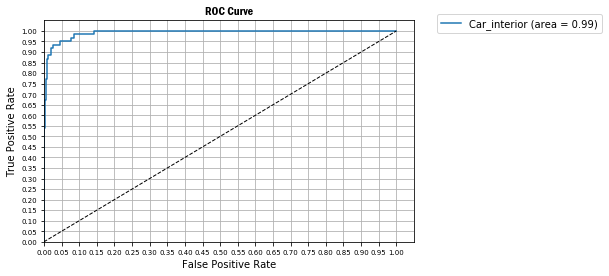

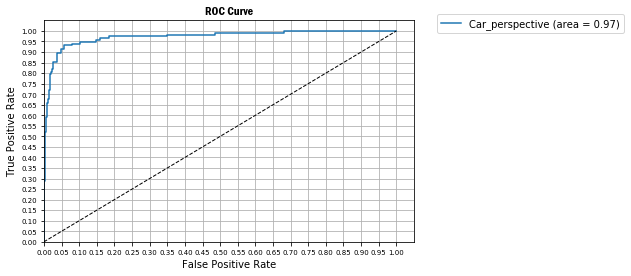

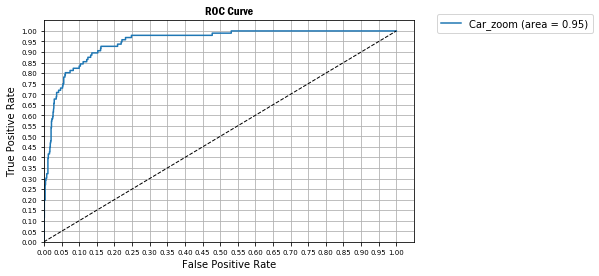

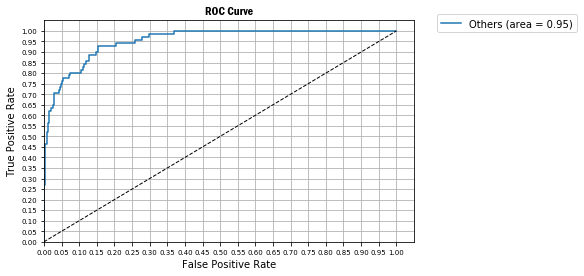

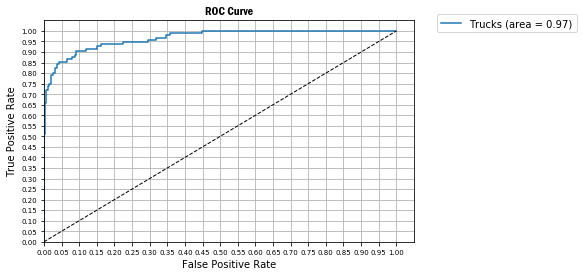

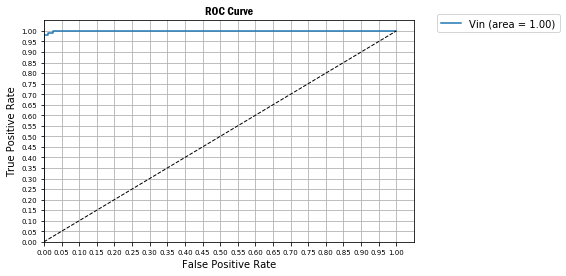

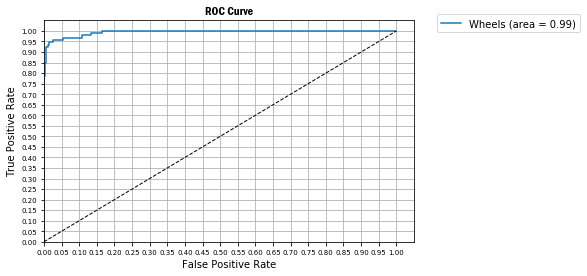

In [15]:
y = label_binarize(test_set_df['category'], classes=[0,1,2,3,4,5,6,7,8,9])
roc(y, y_preds, 10, fig_save_path)

In [18]:
score = model.evaluate(test_generator, steps=len(test_img) // 1)
print(score)
print(model.metrics_names)

986/986 [==============================] - 57s 58ms/step - loss: 0.7364 - acc: 0.8235
[0.7363555461749388, 0.8235294]
['loss', 'acc']


In [ ]:
# Check for corrupted images, save

from PIL import Image

save_dir = r"D:\BOCI_categorized\test_data_Wu\test_data\new"

for idx, i in enumerate(test_img):
    try:
        print(idx+1,'/',len(test_img))
        if not os.path.exists(os.path.join(save_dir, i.split("\\")[-2])):
            os.makedirs(os.path.join(save_dir, i.split("\\")[-2]))
        img = Image.open(i)
        img.save(os.path.join(save_dir, i.split("\\")[-2], i.split("\\")[-1].split(".")[0] + '.' + i.split("\\")[-1].split(".")[-1].lower()))
    except:
        print("Error: ", i)
        continue

In [ ]:
# Check for corrupted images, save

from PIL import Image

dir_path = r"/home/ubuntu/Categorier/data_set"
all_files = glob.glob(dir_path + "\\*\\*")
imagefiles = [file for file in all_files if file.split('\\')[-1].split('.')[-1].lower() in ['jpg', 'jpeg', 'png']]

for idx, i in enumerate(imagefiles):
    try:
        print(idx+1,'/',len(test_img))
        img = Image.open(i)
    except:
        print("Error: ", i)
        break